--- 各ファイルの処理を開始 ---

--- 全てのファイルの処理が完了しました ---


--- データの分析を開始 ---
全データを1つのDataFrameに結合しました。
総行数: 55968, 総列数: 27

--- データ概要 ---
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55968 entries, 0 to 55967
Data columns (total 27 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   label                        55968 non-null  object 
 1   Loudness_sma3                55968 non-null  float64
 2   alphaRatio_sma3              55968 non-null  float64
 3   hammarbergIndex_sma3         55968 non-null  float64
 4   slope0-500_sma3              55968 non-null  float64
 5   slope500-1500_sma3           55968 non-null  float64
 6   spectralFlux_sma3            55968 non-null  float64
 7   mfcc1_sma3                   55968 non-null  float64
 8   mfcc2_sma3                   55968 non-null  float64
 9   mfcc3_sma3                   55968 non-null  float64
 10  mfcc4_sma3                   55968 non-null  float64
 11  F0se

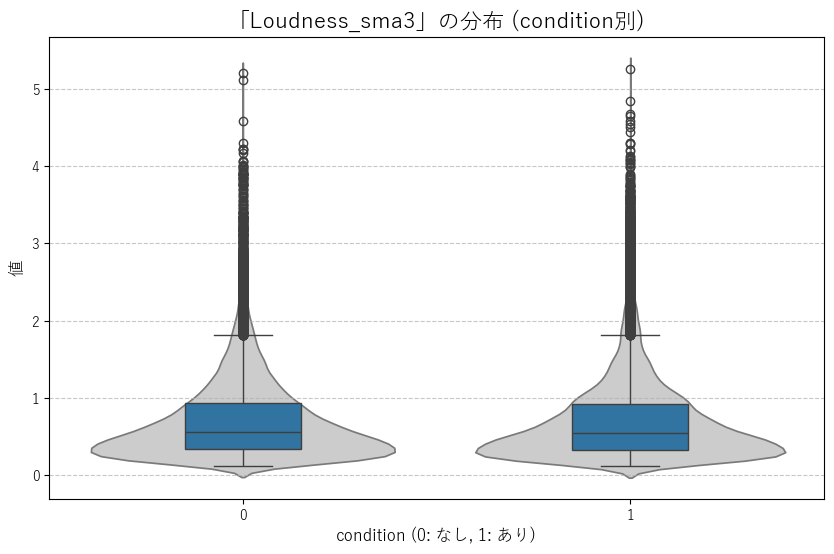

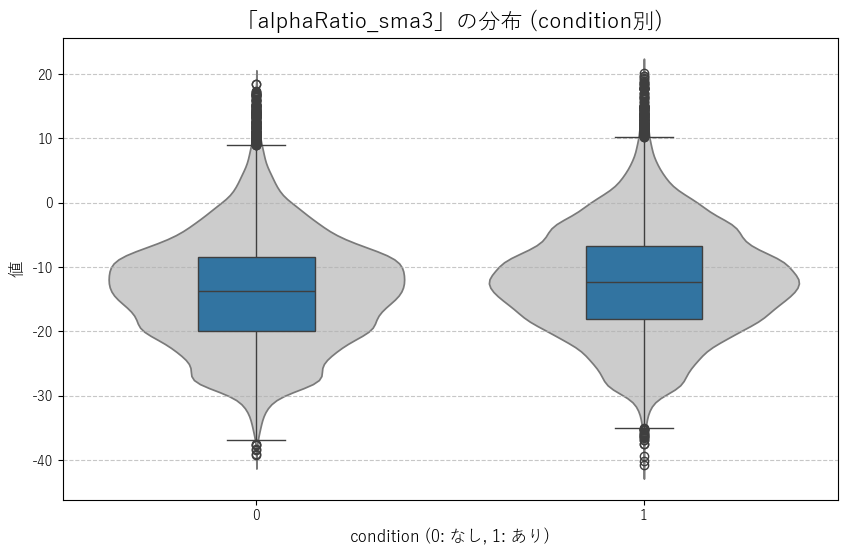

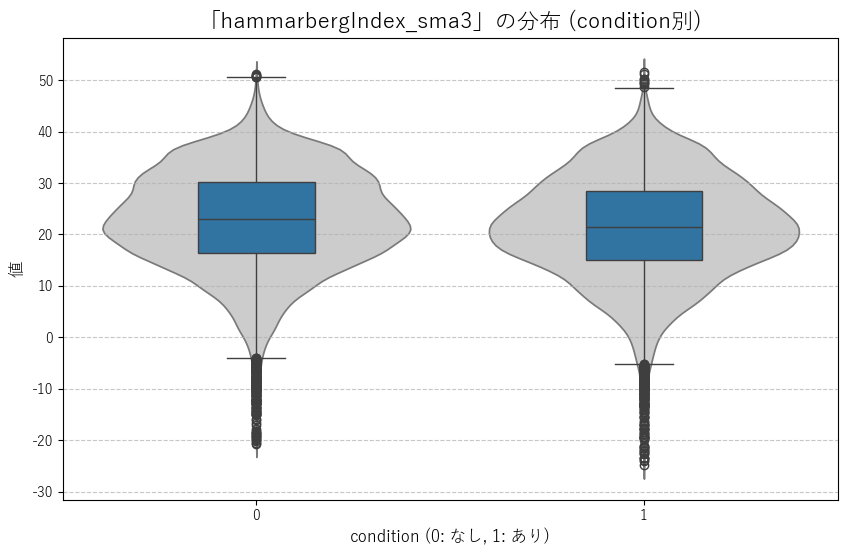

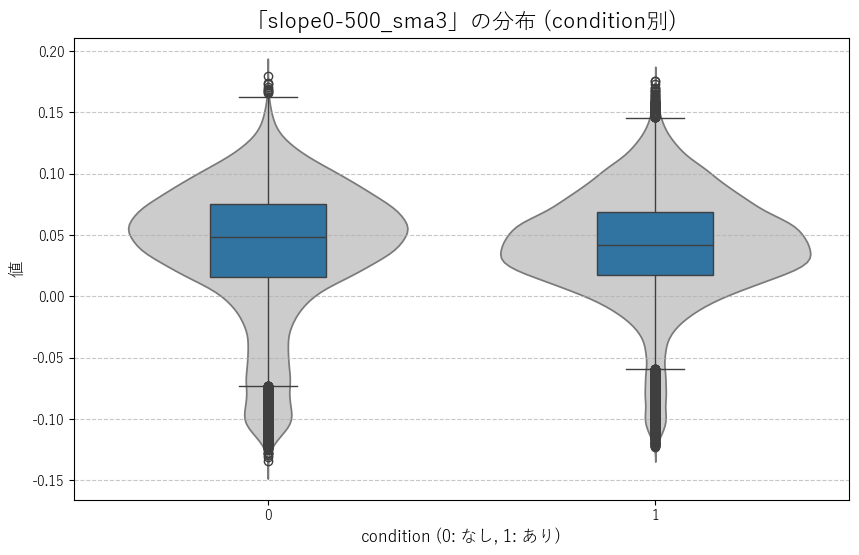

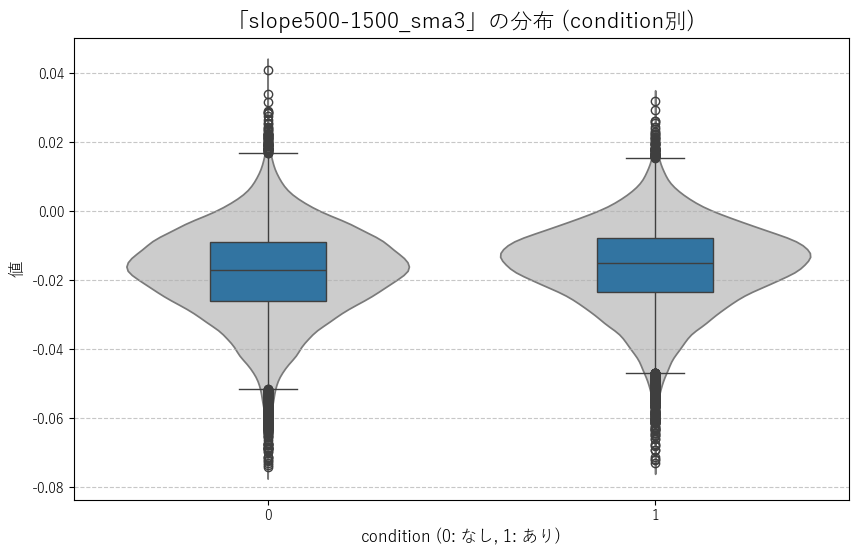

...

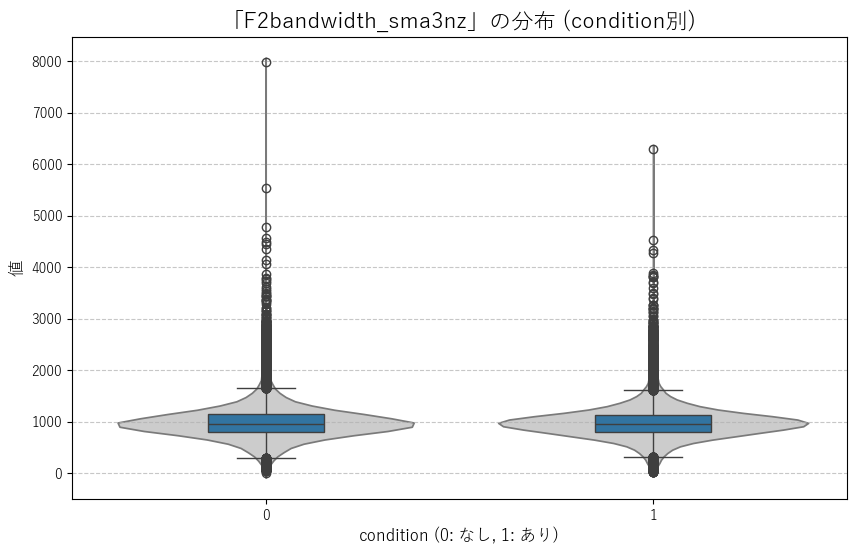

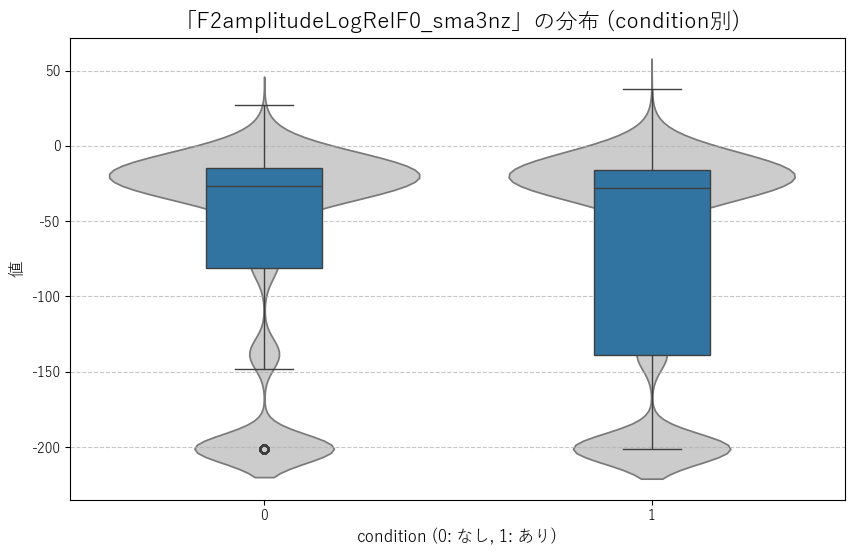

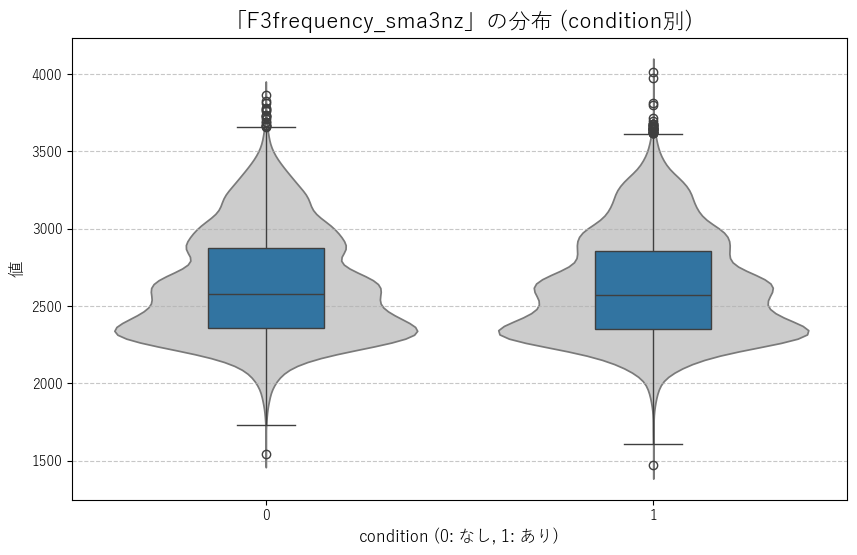

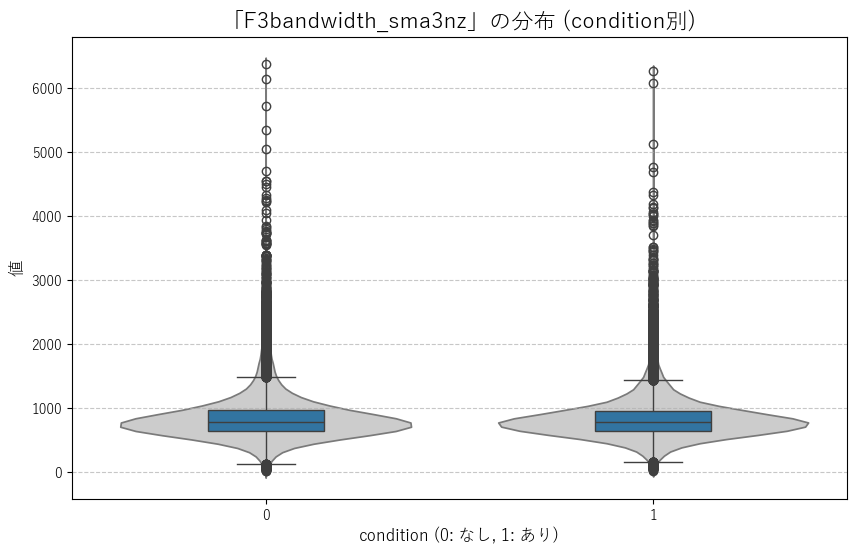

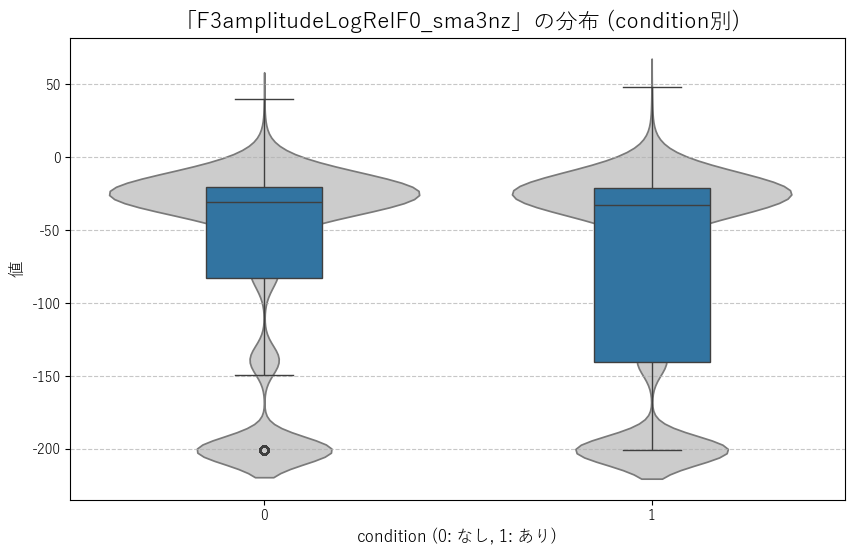


--- データ全体像の可視化 ---


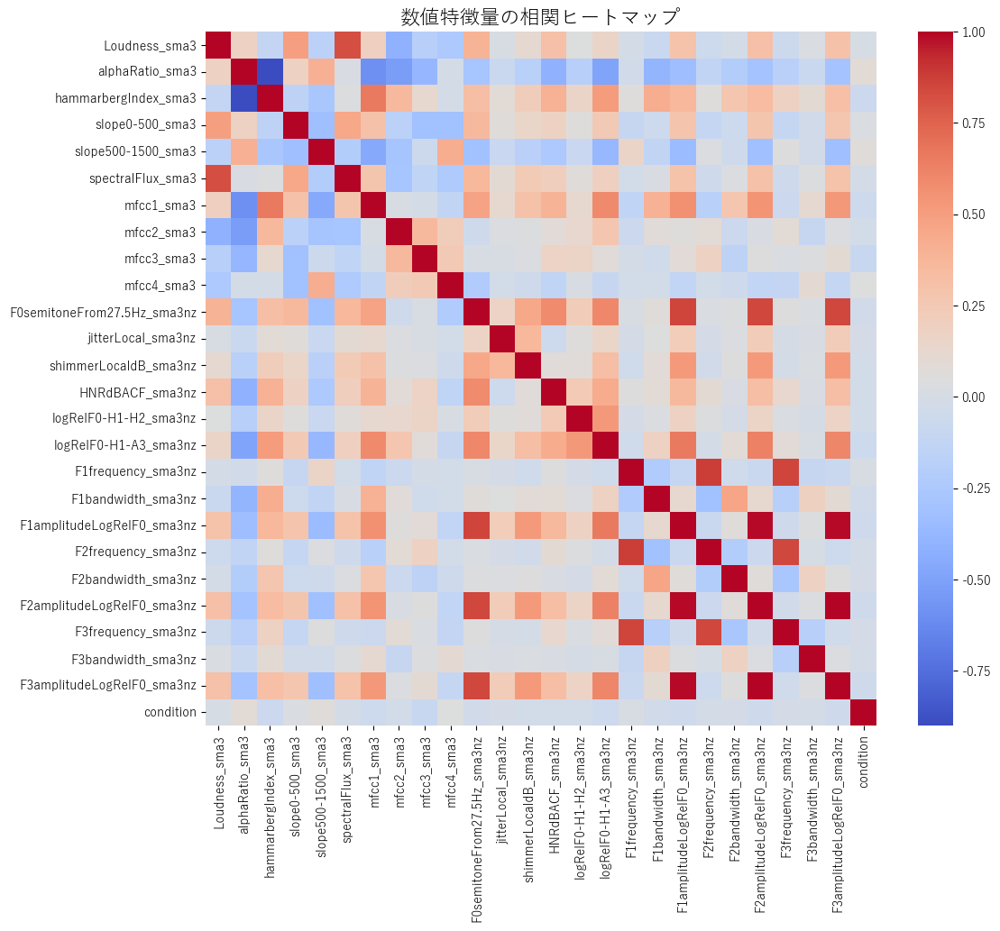


--- 全ての分析が完了しました ---


In [6]:
import pandas as pd
import numpy as np
import glob
import os
import re
import seaborn as sns
import matplotlib.pyplot as plt

# 日本語フォントの設定（文字化け対策）
# ご利用の環境に応じてフォント名を変更してください (例: 'MS Gothic', 'Hiragino Sans')
plt.rcParams['font.sans-serif'] = ['Yu Gothic', 'Arial Unicode MS', 'Meiryo']
plt.rcParams['axes.unicode_minus'] = False # マイナス記号の文字化け対策

# ======================================================================
# 関数定義パート
# ======================================================================

def process_csvs_into_dict(input_folder, new_column_name, values_list, column_to_filter='label', columns_to_drop=None):
    """指定フォルダ内の各CSVファイルを個別に処理し、その結果を辞書に格納して返します。"""
    if not os.path.isdir(input_folder):
        print(f"エラー: 入力フォルダ '{input_folder}' が見つかりません。")
        return {}
    
    # ファイルを数値順にソートしてリストアップ
    csv_pattern = os.path.join(input_folder, '*.csv')
    csv_files = glob.glob(csv_pattern)
    def extract_number(filename):
        match = re.search(r'\d+', os.path.basename(filename))
        return int(match.group()) if match else 0
    csv_files.sort(key=extract_number)

    if not csv_files:
        print(f"フォルダ '{input_folder}' にCSVファイルが見つかりませんでした。")
        return {}
        
    if len(csv_files) != len(values_list):
        print(f"警告: ファイル数 ({len(csv_files)}) と値のリストの長さ ({len(values_list)}) が一致しません。")

    processed_dfs = {}
    print("--- 各ファイルの処理を開始 ---")
    for i, file_path in enumerate(csv_files):
        basename = os.path.basename(file_path)
        try:
            df = pd.read_csv(file_path, encoding='utf-8')
            if i < len(values_list):
                df[new_column_name] = values_list[i]
            else:
                df[new_column_name] = None
            if column_to_filter and column_to_filter in df.columns:
                target_labels = [f'answer{j}' for j in range(1, 11)]
                
                # ▼▼▼ ここを修正 ▼▼▼
                # .astype(str)で列を文字列型に変換し、.str.strip()で前後の空白を削除してからフィルタリング
                df = df[df[column_to_filter].astype(str).str.strip().isin(target_labels)].copy()
                # ▲▲▲▲▲▲▲▲▲▲▲▲

            if columns_to_drop:
                df = df.drop(columns=[col for col in columns_to_drop if col in df.columns], errors='ignore')
            df.reset_index(drop=True, inplace=True)
            processed_dfs[basename] = df
        except Exception as e:
            print(f"  ** エラー: ファイル '{basename}' の処理中に問題が発生しました: {e} **")
            continue
    print("\n--- 全てのファイルの処理が完了しました ---")
    return processed_dfs

def compare_features_by_condition(df, features, target_col):
    """指定した特徴量の分布を、ターゲット変数のグループごとに比較して可視化します。"""
    print(f"\n--- 特徴量ごとの分布比較 (by {target_col}) ---")
    for feature in features:
        plt.figure(figsize=(10, 6))
        # バイオリンプロット（分布の形状）と箱ひげ図（統計量）を重ねる
        sns.violinplot(x=target_col, y=feature, data=df, inner=None, color=".8")
        sns.boxplot(x=target_col, y=feature, data=df, width=0.3)
        plt.title(f'「{feature}」の分布 ({target_col}別)', fontsize=16)
        plt.xlabel(f'{target_col} (0: なし, 1: あり)', fontsize=12)
        plt.ylabel('値', fontsize=12)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.show()

def analyze_data(data_dict, target_col_name):
    """前処理済みのDataFrame辞書から、データ分析と可視化を包括的に行います。"""
    if not data_dict:
        print("分析対象のデータがありません。処理を終了します。")
        return None

    print("\n\n--- データの分析を開始 ---")
    
    # 1. 全てのDataFrameを1つに結合
    combined_df = pd.concat(data_dict.values(), ignore_index=True)
    print("全データを1つのDataFrameに結合しました。")
    print(f"総行数: {len(combined_df)}, 総列数: {len(combined_df.columns)}")
    
    # 2. 基本情報の確認
    print("\n--- データ概要 ---")
    combined_df.info()
    
    print("\n--- 基本統計量（数値データ） ---")
    print(combined_df.describe())

    # 3. 統計量によるグループ比較
    feature_columns = combined_df.columns.drop(['label', target_col_name])
    print(f"\n--- {target_col_name}別 の基本統計量比較 ---")
    grouped_stats = combined_df.groupby(target_col_name)[feature_columns].describe().T
    print(grouped_stats)

    # 4. 可視化によるグループ比較
    compare_features_by_condition(combined_df, feature_columns, target_col_name)

    # 5. 全体像の可視化
    print("\n--- データ全体像の可視化 ---")
    numeric_df = combined_df.select_dtypes(include=['number'])
    if not numeric_df.empty:
        # 相関ヒートマップ
        plt.figure(figsize=(12, 10))
        correlation_matrix = numeric_df.corr()
        sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm') # annot=Falseで数値非表示
        plt.title('数値特徴量の相関ヒートマップ', fontsize=16)
        plt.show()
    
    print("\n--- 全ての分析が完了しました ---")
    return combined_df

# ======================================================================
# 実行パート
# ======================================================================

if __name__ == '__main__':
    # --- パラメータ設定 ---
    input_folder_path = './voice_csv'
    columns_to_remove = ['start', 'end', 'original_start', 'original_end'] 
    values_for_files = [0,0,1,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,0,1,1,1,0,1,1,1,1,1,1,1,1,1,1,0,0,1,1,1,1,1] 
    new_column_name_to_add = 'condition'

    # --- ステップ1: データの前処理と読み込み ---
    all_data_dfs_dict = process_csvs_into_dict(
        input_folder_path,
        new_column_name=new_column_name_to_add,
        values_list=values_for_files,
        column_to_filter='label', 
        columns_to_drop=columns_to_remove
    )

    # --- ステップ2: 統合的なデータ分析の実行 ---
    if all_data_dfs_dict:
        # 分析関数を呼び出し、必要であれば結合後のDataFrameを受け取る
        final_combined_df = analyze_data(all_data_dfs_dict, new_column_name_to_add)

--- 各ファイルの処理を開始 ---
処理中: ID30_30_answers.csv
処理中: ID31_30_answers.csv
処理中: ID32_30_answers.csv
処理中: ID33_30_answers.csv
処理中: ID34_30_answers.csv
処理中: ID35_30_answers.csv
処理中: ID36_30_answers.csv
処理中: ID37_30_answers.csv
処理中: ID38_30_answers.csv
処理中: ID39_30_answers.csv
処理中: ID40_30_answers.csv
処理中: ID41_30_answers.csv
処理中: ID42_30_answers.csv
処理中: ID43_30_answers.csv
処理中: ID44_30_answers.csv
処理中: ID45_30_answers.csv
処理中: ID46_30_answers.csv
処理中: ID47_30_answers.csv
処理中: ID48_30_answers.csv
処理中: ID49_30_answers.csv
処理中: ID50_30_answers.csv
処理中: ID51_30_answers.csv
処理中: ID52_30_answers.csv
処理中: ID53_30_answers.csv
処理中: ID54_30_answers.csv
処理中: ID55_30_answers.csv
処理中: ID56_30_answers.csv
処理中: ID57_30_answers.csv
処理中: ID58_30_answers.csv
処理中: ID59_30_answers.csv
処理中: ID60_30_answers.csv
処理中: ID61_30_answers.csv
処理中: ID62_30_answers.csv
処理中: ID63_30_answers.csv
処理中: ID64_30_answers.csv
処理中: ID65_30_answers.csv
処理中: ID66_30_answers.csv
処理中: ID67_30_answers.csv
処理中: ID68_30_answers.csv
処理中: 

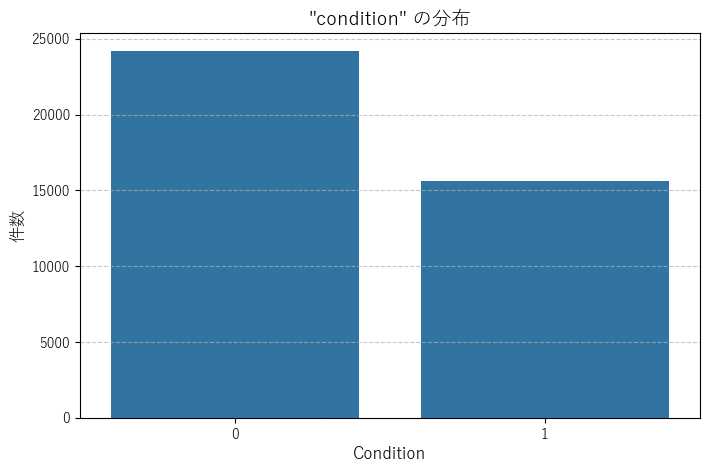

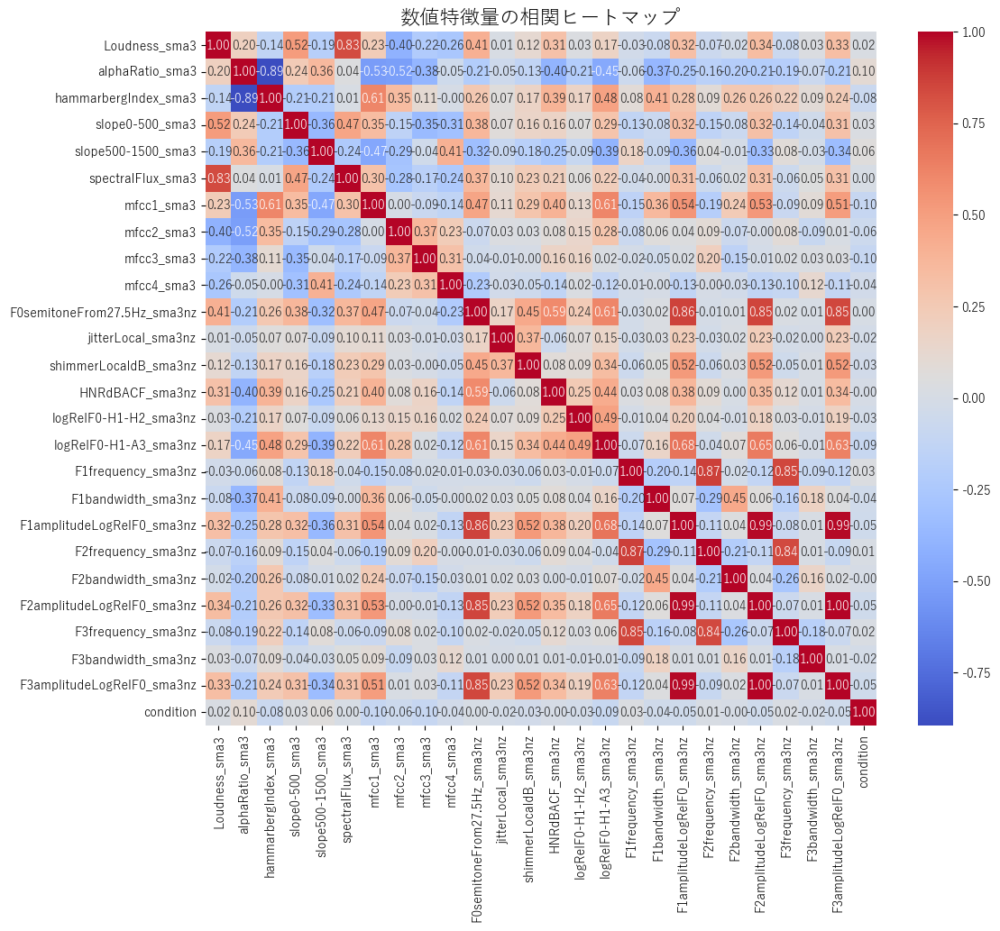

ペアプロットの描画を開始します... (データ量により時間がかかる場合があります)


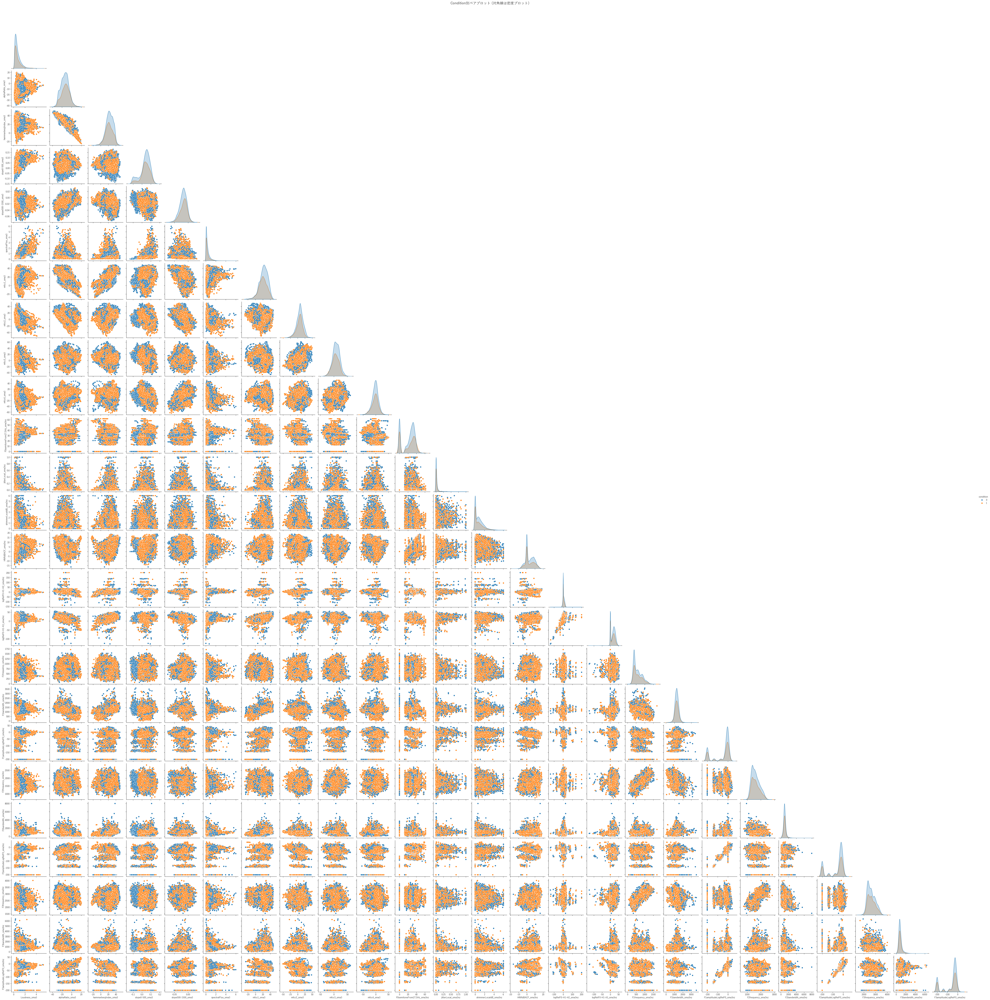


--- 全ての分析が完了しました ---


In [4]:
import pandas as pd
import glob
import os
import re
import seaborn as sns
import matplotlib.pyplot as plt

# 日本語フォントの設定（文字化け対策）
# ご利用の環境に応じてフォント名を変更してください (例: 'MS Gothic', 'Hiragino Sans')
plt.rcParams['font.sans-serif'] = ['Yu Gothic', 'Arial Unicode MS', 'Meiryo']
plt.rcParams['axes.unicode_minus'] = False # マイナス記号の文字化け対策


def process_csvs_into_dict(input_folder, new_column_name, values_list, column_to_filter='label', columns_to_drop=None):
    """
    指定フォルダ内の各CSVファイルを個別に処理し、その結果を辞書に格納して返します。
    （この関数はご提示のコードのままです）
    """
    # --- 準備 ---
    if not os.path.isdir(input_folder):
        print(f"エラー: 入力フォルダ '{input_folder}' が見つかりません。")
        return {}

    # ファイルを数値順にソートしてリストアップ
    csv_pattern = os.path.join(input_folder, '*.csv')
    csv_files = glob.glob(csv_pattern)
    
    def extract_number(filename):
        match = re.search(r'\d+', os.path.basename(filename))
        return int(match.group()) if match else 0
    csv_files.sort(key=extract_number)

    if not csv_files:
        print(f"フォルダ '{input_folder}' にCSVファイルが見つかりませんでした。")
        return {}
        
    if len(csv_files) != len(values_list):
        print(f"警告: ファイル数 ({len(csv_files)}) と値のリストの長さ ({len(values_list)}) が一致しません。")

    # --- 各ファイルを個別に処理し、辞書に格納 ---
    processed_dfs = {} # 処理済みDataFrameを格納する空の辞書
    
    print("--- 各ファイルの処理を開始 ---")
    for i, file_path in enumerate(csv_files):
        basename = os.path.basename(file_path)
        print(f"処理中: {basename}")

        try:
            # 1. ファイルを読み込む
            df = pd.read_csv(file_path, encoding='utf-8')

            # 2. ファイルの順番に応じた値を持つ新しい列を追加
            if i < len(values_list):
                df[new_column_name] = values_list[i]
            else:
                df[new_column_name] = None 

            # 3. 'label'列の値に基づいて行をフィルタリング
            if column_to_filter and column_to_filter in df.columns:
                target_labels = [f'answer{i}' for i in range(1, 11)]
                df = df[df[column_to_filter].isin(target_labels)].copy()

            # 4. 不要な列を削除
            if columns_to_drop:
                existing_cols_to_drop = [col for col in columns_to_drop if col in df.columns]
                if existing_cols_to_drop:
                    df = df.drop(columns=existing_cols_to_drop)

            # 5. 処理後のDataFrameを辞書に格納
            df.reset_index(drop=True, inplace=True)
            processed_dfs[basename] = df
            
        except Exception as e:
            print(f"  ** エラー: ファイル '{basename}' の処理中に問題が発生しました: {e} **")
            continue
            
    print("\n--- 全てのファイルの処理が完了しました ---")
    return processed_dfs

# ===============================================================
# === ここからが新しく追加した分析パートです ===
# ===============================================================

def analyze_data(data_dict):
    """
    前処理済みのDataFrame辞書を受け取り、結合してデータ分析と可視化を行います。
    
    Args:
        data_dict (dict): ファイル名をキー、DataFrameをバリューとする辞書。
    """
    if not data_dict:
        print("分析対象のデータがありません。処理を終了します。")
        return

    print("\n\n--- データの分析を開始 ---")
    
    # 1. 全てのDataFrameを1つに結合
    combined_df = pd.concat(data_dict.values(), ignore_index=True)
    print("全データを1つのDataFrameに結合しました。")
    print(f"総行数: {len(combined_df)}, 総列数: {len(combined_df.columns)}")
    
    # 2. 基本情報の確認
    print("\n--- データ概要 ---")
    combined_df.info()
    
    print("\n--- 基本統計量（数値データ） ---")
    print(combined_df.describe())

    # 3. カテゴリデータの分布を確認
    print(f"\n--- '{new_column_name_to_add}' 列のデータ数 ---")
    print(combined_df[new_column_name_to_add].value_counts())
    
    print("\n--- 'label' 列のデータ数 ---")
    print(combined_df['label'].value_counts())

    # 4. データの可視化
    print("\n--- データの可視化を開始 ---")
    
    # 可視化①: condition列の分布を棒グラフで表示
    plt.figure(figsize=(8, 5))
    sns.countplot(x=new_column_name_to_add, data=combined_df)
    plt.title(f'"{new_column_name_to_add}" の分布', fontsize=14)
    plt.xlabel('Condition', fontsize=12)
    plt.ylabel('件数', fontsize=12)
    plt.grid(axis='y', linestyle='--', alpha=0.7)
    plt.show()

    # 可視化②: 数値データ全ての相関ヒートマップ
    # object型やcategory型の列を除外して相関を計算
    numeric_df = combined_df.select_dtypes(include=['number'])
    if not numeric_df.empty:
        plt.figure(figsize=(12, 10))
        correlation_matrix = numeric_df.corr()
        sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f')
        plt.title('数値特徴量の相関ヒートマップ', fontsize=16)
        plt.show()
    else:
        print("警告: 相関を計算できる数値データがありません。")

    # 可視化③: ... (ペアプロット)
    if not numeric_df.empty:
        print("ペアプロットの描画を開始します... (データ量により時間がかかる場合があります)")
        # numeric_df には既に'condition'列が含まれているため、そのまま使用する
        sns.pairplot(numeric_df, hue=new_column_name_to_add, corner=True)
        plt.suptitle('Condition別ペアプロット (対角線は密度プロット)', y=1.02, fontsize=16)
        plt.show()

    print("\n--- 全ての分析が完了しました ---")


# --- ここから実行 ---

# 1. 読み込むCSVファイルが保存されているフォルダ
input_folder_path = './voice_csv'

# 2. 削除したい列の名前のリスト
columns_to_remove = ['start', 'end', 'original_start', 'original_end'] 

# 3. ファイルごとに割り当てる値のリスト
values_for_files = [0,0,1,0,1,
          0,0,0,0,0,
          0,0,0,1,1,
          0,1,0,1,0,
          0,0,0,0,1,
          0,1,1,0,0,
          0,0,0,1,0,
          1,0,0,0,1,
          1,1,1,0,1,
          1,1,0,1,1,
          1,1,1,1,1,
          1,1,1,0,0,
          1,1,1,1,1] 

# 4. 追加する新しい列の名前
new_column_name_to_add = 'condition'

# ステップ1: ご提示の関数で前処理を実行
all_data_dfs_dict = process_csvs_into_dict(
    input_folder_path,
    new_column_name=new_column_name_to_add,
    values_list=values_for_files,
    column_to_filter='label', 
    columns_to_drop=columns_to_remove
)

# ステップ2: 新しい関数で分析を実行
analyze_data(all_data_dfs_dict)

--- 各ファイルの処理を開始 ---

--- 全てのファイルの処理が完了しました ---


--- データの分析を開始 ---
全データを1つのDataFrameに結合しました。
総行数: 55968, 総列数: 27

--- データ概要 ---
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55968 entries, 0 to 55967
Data columns (total 27 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   label                        55968 non-null  object 
 1   Loudness_sma3                55968 non-null  float64
 2   alphaRatio_sma3              55968 non-null  float64
 3   hammarbergIndex_sma3         55968 non-null  float64
 4   slope0-500_sma3              55968 non-null  float64
 5   slope500-1500_sma3           55968 non-null  float64
 6   spectralFlux_sma3            55968 non-null  float64
 7   mfcc1_sma3                   55968 non-null  float64
 8   mfcc2_sma3                   55968 non-null  float64
 9   mfcc3_sma3                   55968 non-null  float64
 10  mfcc4_sma3                   55968 non-null  float64
 11  F0se

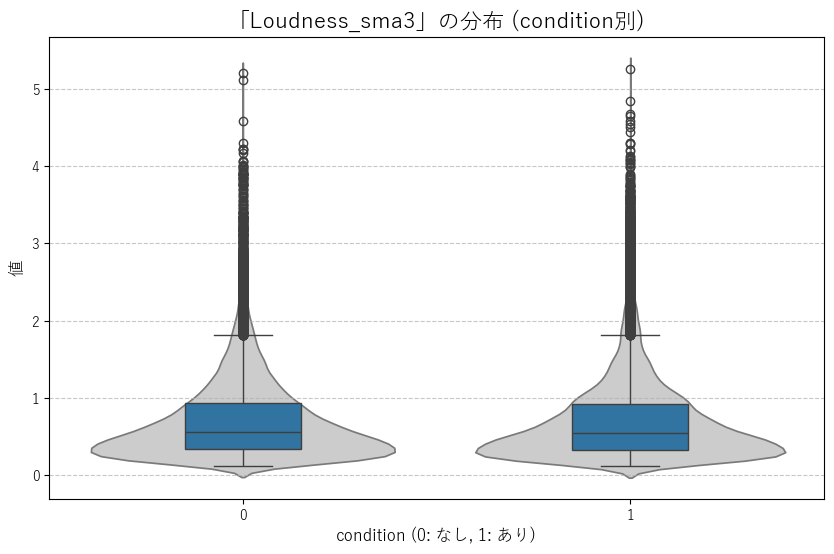

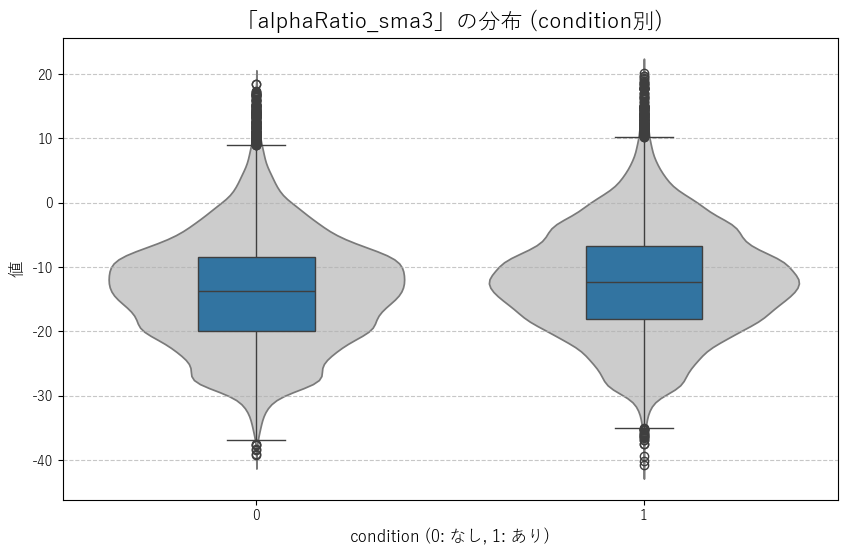

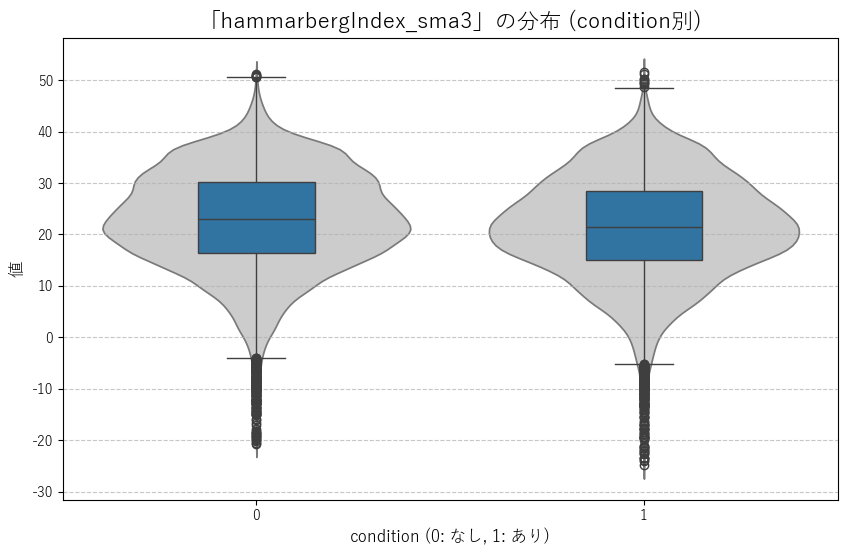

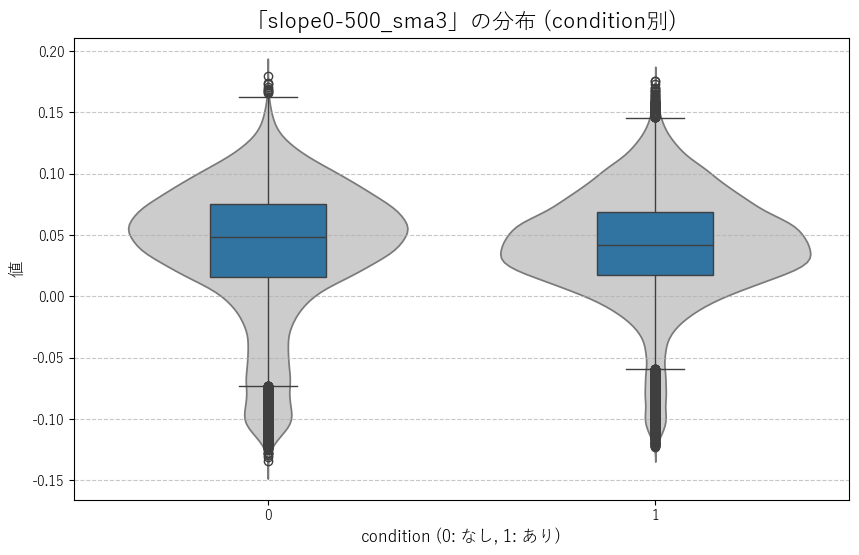

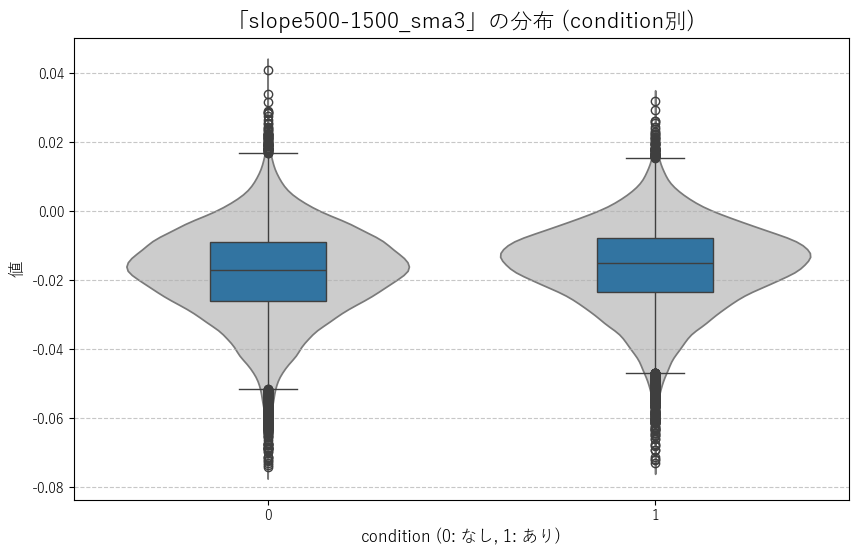

...

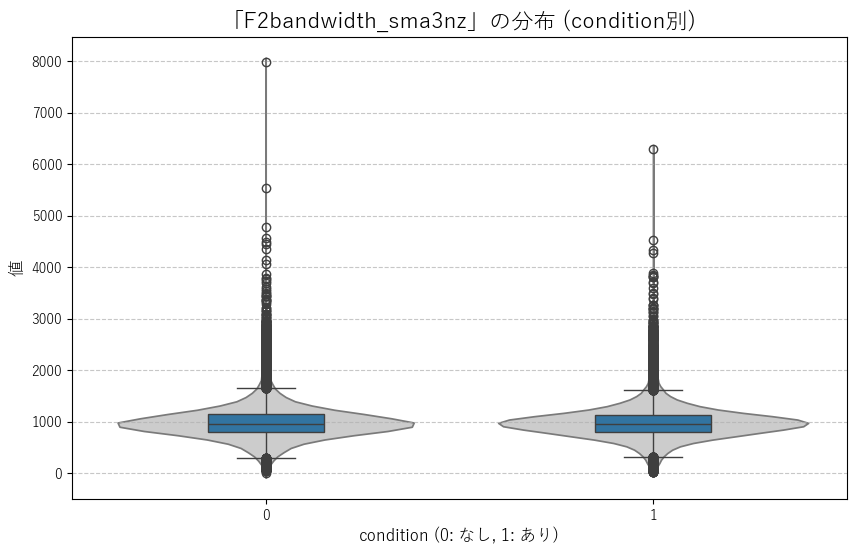

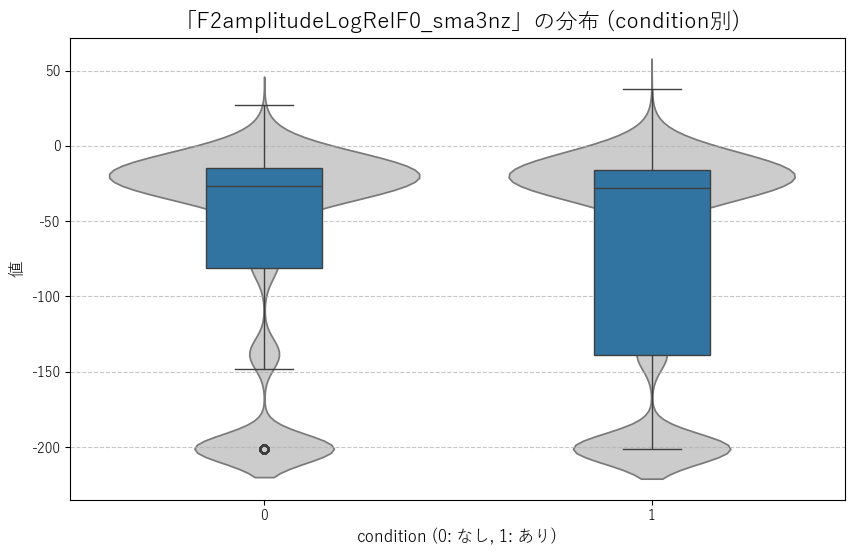

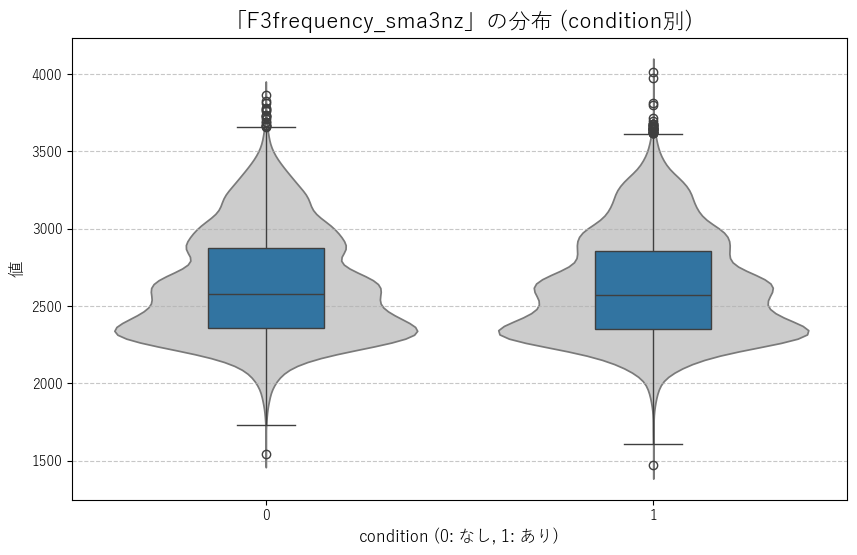

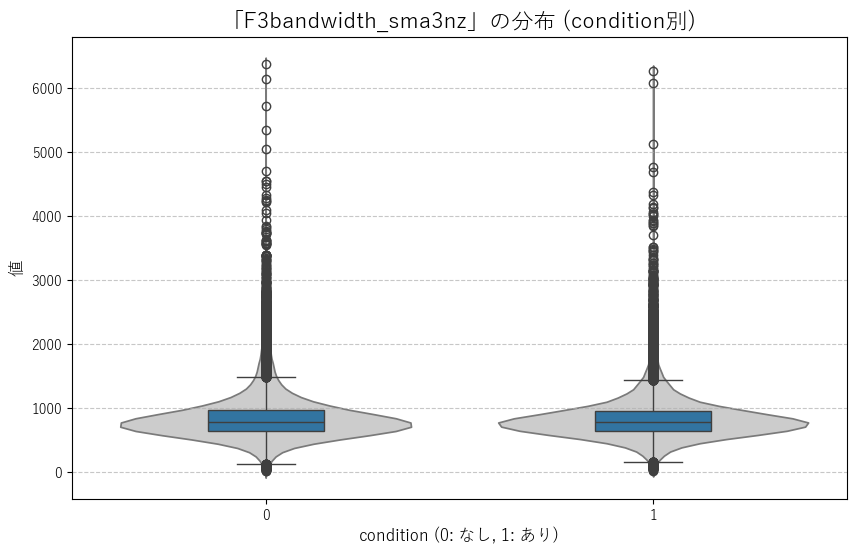

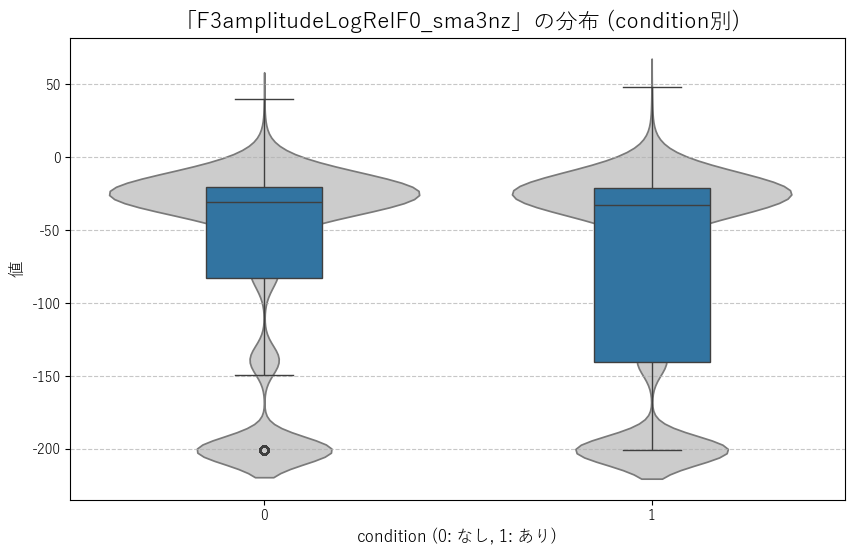


--- データ全体像の可視化 ---


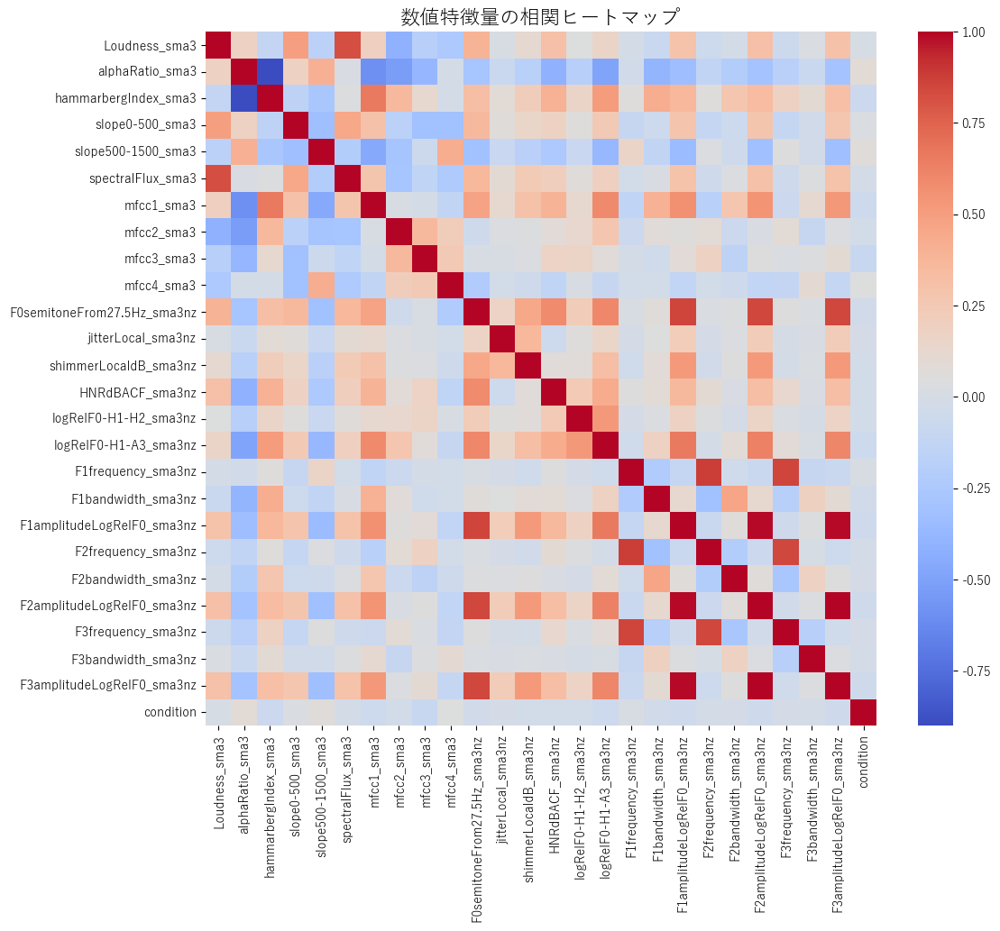


--- 全ての分析が完了しました ---


In [1]:
import pandas as pd
import numpy as np
import glob
import os
import re
import seaborn as sns
import matplotlib.pyplot as plt

# 日本語フォントの設定（文字化け対策）
plt.rcParams['font.sans-serif'] = ['Yu Gothic', 'Arial Unicode MS', 'Meiryo']
plt.rcParams['axes.unicode_minus'] = False 

# ======================================================================
# 関数定義パート (process_csvs_into_dict, compare_features_by_condition は変更なし)
# ======================================================================

def process_csvs_into_dict(input_folder, new_column_name, values_list, column_to_filter='label', columns_to_drop=None):
    """指定フォルダ内の各CSVファイルを個別に処理し、その結果を辞書に格納して返します。"""
    if not os.path.isdir(input_folder):
        print(f"エラー: 入力フォルダ '{input_folder}' が見つかりません。")
        return {}
    
    # ファイルを数値順にソートしてリストアップ
    csv_pattern = os.path.join(input_folder, '*.csv')
    csv_files = glob.glob(csv_pattern)
    def extract_number(filename):
        match = re.search(r'\d+', os.path.basename(filename))
        return int(match.group()) if match else 0
    csv_files.sort(key=extract_number)

    if not csv_files:
        print(f"フォルダ '{input_folder}' にCSVファイルが見つかりませんでした。")
        return {}
        
    if len(csv_files) != len(values_list):
        print(f"警告: ファイル数 ({len(csv_files)}) と値のリストの長さ ({len(values_list)}) が一致しません。")

    processed_dfs = {}
    print("--- 各ファイルの処理を開始 ---")
    for i, file_path in enumerate(csv_files):
        basename = os.path.basename(file_path)
        try:
            df = pd.read_csv(file_path, encoding='utf-8')
            if i < len(values_list):
                df[new_column_name] = values_list[i]
            else:
                df[new_column_name] = None
            if column_to_filter and column_to_filter in df.columns:
                target_labels = [f'answer{j}' for j in range(1, 11)]
                df = df[df[column_to_filter].astype(str).str.strip().isin(target_labels)].copy()
            if columns_to_drop:
                df = df.drop(columns=[col for col in columns_to_drop if col in df.columns], errors='ignore')
            df.reset_index(drop=True, inplace=True)
            processed_dfs[basename] = df
        except Exception as e:
            print(f"  ** エラー: ファイル '{basename}' の処理中に問題が発生しました: {e} **")
            continue
    print("\n--- 全てのファイルの処理が完了しました ---")
    return processed_dfs

def compare_features_by_condition(df, features, target_col):
    """指定した特徴量の分布を、ターゲット変数のグループごとに比較して可視化します。"""
    print(f"\n--- 特徴量ごとの分布比較 (by {target_col}) ---")
    for feature in features:
        plt.figure(figsize=(10, 6))
        sns.violinplot(x=target_col, y=feature, data=df, inner=None, color=".8")
        sns.boxplot(x=target_col, y=feature, data=df, width=0.3)
        plt.title(f'「{feature}」の分布 ({target_col}別)', fontsize=16)
        plt.xlabel(f'{target_col} (0: なし, 1: あり)', fontsize=12)
        plt.ylabel('値', fontsize=12)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.show()

def analyze_data(data_dict, target_col_name):
    """前処理済みのDataFrame辞書から、データ分析と可視化を包括的に行います。"""
    if not data_dict:
        print("分析対象のデータがありません。処理を終了します。")
        return None

    print("\n\n--- データの分析を開始 ---")
    
    # 1. 全てのDataFrameを1つに結合
    combined_df = pd.concat(data_dict.values(), ignore_index=True)
    print("全データを1つのDataFrameに結合しました。")
    print(f"総行数: {len(combined_df)}, 総列数: {len(combined_df.columns)}")
    
    # 2. 基本情報の確認
    print("\n--- データ概要 ---")
    pd.set_option('display.max_rows', None) # ### ▼▼▼ 変更箇所 ▼▼▼ ### 省略せずに全列の情報を表示
    combined_df.info()
    pd.reset_option('display.max_rows') # ### ▼▼▼ 変更箇所 ▼▼▼ ### 設定を元に戻す
    
    print("\n--- 基本統計量（数値データ） ---")
    print(combined_df.describe())

    ### ▼▼▼ ここからが統計量表示の修正・追加パートです ▼▼▼ ###

    # 3. 統計量によるグループ比較
    feature_columns = combined_df.columns.drop(['label', target_col_name])
    print(f"\n--- {target_col_name}別 の基本統計量比較 ---")
    
    # グループごとの統計量を計算
    # .T で転置（行と列を入れ替え）すると見やすくなる
    grouped_stats = combined_df.groupby(target_col_name)[feature_columns].describe().T
    
    # --- condition = 0 の統計量を表示 ---
    if 0 in grouped_stats.columns:
        print("\n--- condition = 0 の統計量 ---")
        # grouped_statsから condition=0 の部分だけを抽出して表示
        stats_0 = grouped_stats[0]
        print(stats_0)
    else:
        print("\ncondition = 0 のデータはありません。")

    # --- condition = 1 の統計量を表示 ---
    if 1 in grouped_stats.columns:
        print("\n--- condition = 1 の統計量 ---")
        # grouped_statsから condition=1 の部分だけを抽出して表示
        stats_1 = grouped_stats[1]
        print(stats_1)
    else:
        print("\ncondition = 1 のデータはありません。")
        
    # --- 結合した統計量テーブルをCSVファイルに保存 ---
    output_filename = 'grouped_statistics.csv'
    grouped_stats.to_csv(output_filename, encoding='utf-8-sig')
    print(f"\n★ グループ別の全統計量を '{output_filename}' に保存しました。")

    ### ▲▲▲ ここまでが修正・追加パートです ▲▲▲ ###

    # 4. 可視化によるグループ比較
    compare_features_by_condition(combined_df, feature_columns, target_col_name)

    # 5. 全体像の可視化
    print("\n--- データ全体像の可視化 ---")
    numeric_df = combined_df.select_dtypes(include=['number'])
    if not numeric_df.empty:
        # 相関ヒートマップ
        plt.figure(figsize=(12, 10))
        correlation_matrix = numeric_df.corr()
        sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
        plt.title('数値特徴量の相関ヒートマップ', fontsize=16)
        plt.show()
    
    print("\n--- 全ての分析が完了しました ---")
    return combined_df

# ======================================================================
# 実行パート (変更なし)
# ======================================================================

if __name__ == '__main__':
    # --- パラメータ設定 ---
    input_folder_path = './voice_csv'
    columns_to_remove = ['start', 'end', 'original_start', 'original_end'] 
    values_for_files = [0,0,1,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,0,1,1,1,0,1,1,1,1,1,1,1,1,1,1,0,0,1,1,1,1,1] 
    new_column_name_to_add = 'condition'

    # --- ステップ1: データの前処理と読み込み ---
    all_data_dfs_dict = process_csvs_into_dict(
        input_folder_path,
        new_column_name=new_column_name_to_add,
        values_list=values_for_files,
        column_to_filter='label', 
        columns_to_drop=columns_to_remove
    )

    # --- ステップ2: 統合的なデータ分析の実行 ---
    if all_data_dfs_dict:
        final_combined_df = analyze_data(all_data_dfs_dict, new_column_name_to_add)

## 特徴量の比較（F2vsF3 amplitude）

--- 各ファイルの処理を開始 ---

--- 全てのファイルの処理が完了しました ---


--- データの分析を開始 ---
全データを1つのDataFrameに結合しました。
総行数: 55968, 総列数: 27

--- データ概要 ---
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 55968 entries, 0 to 55967
Data columns (total 27 columns):
 #   Column                       Non-Null Count  Dtype  
---  ------                       --------------  -----  
 0   label                        55968 non-null  object 
 1   Loudness_sma3                55968 non-null  float64
 2   alphaRatio_sma3              55968 non-null  float64
 3   hammarbergIndex_sma3         55968 non-null  float64
 4   slope0-500_sma3              55968 non-null  float64
 5   slope500-1500_sma3           55968 non-null  float64
 6   spectralFlux_sma3            55968 non-null  float64
 7   mfcc1_sma3                   55968 non-null  float64
 8   mfcc2_sma3                   55968 non-null  float64
 9   mfcc3_sma3                   55968 non-null  float64
 10  mfcc4_sma3                   55968 non-null  float64
 11  F0se

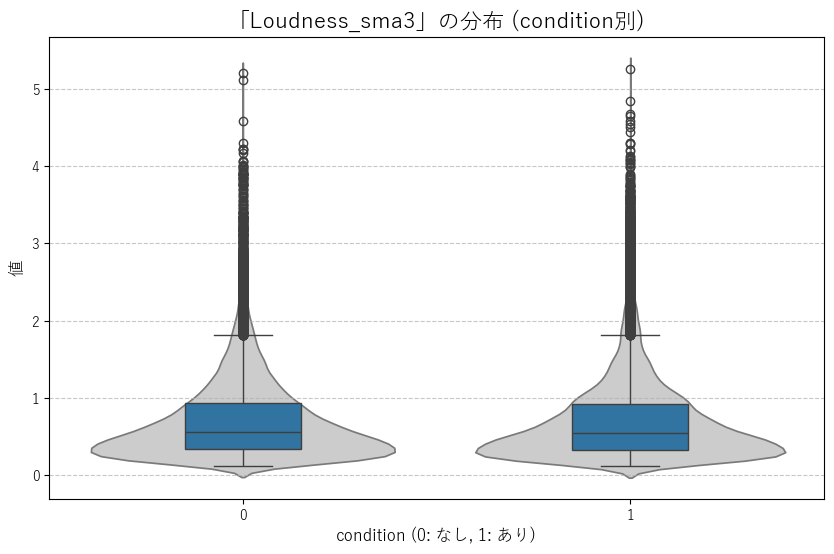

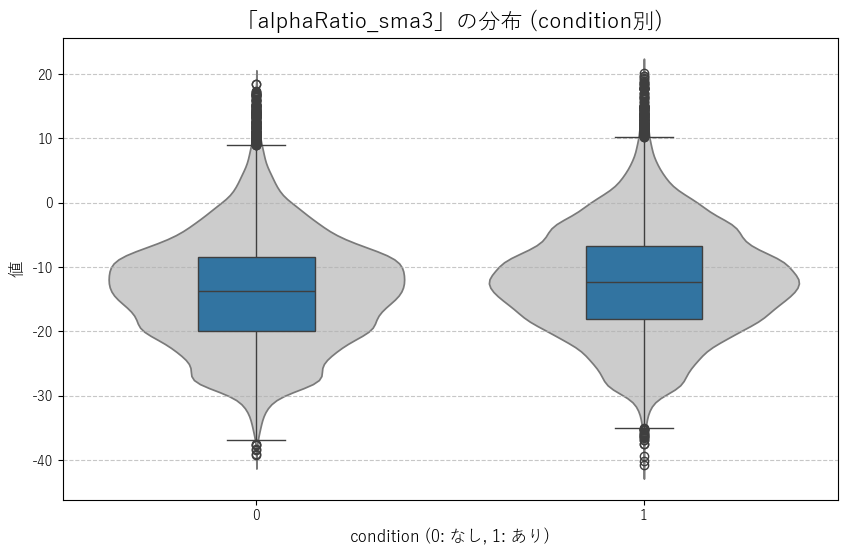

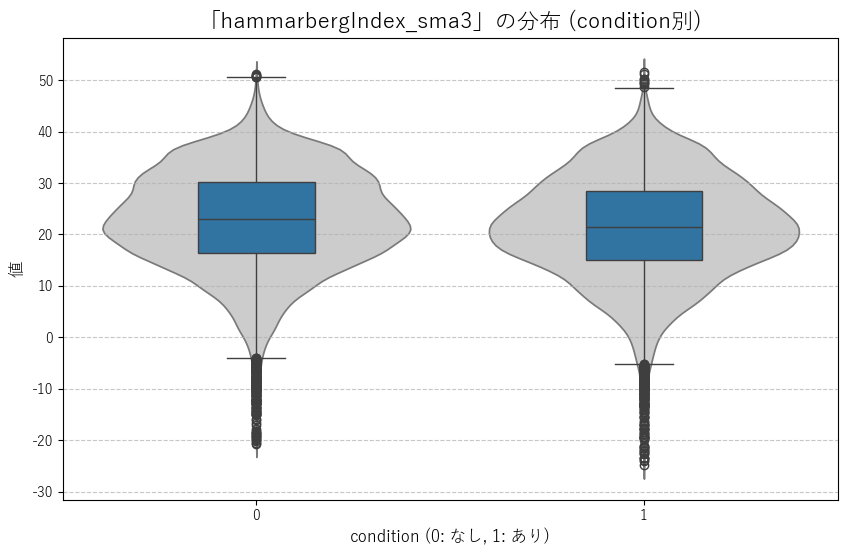

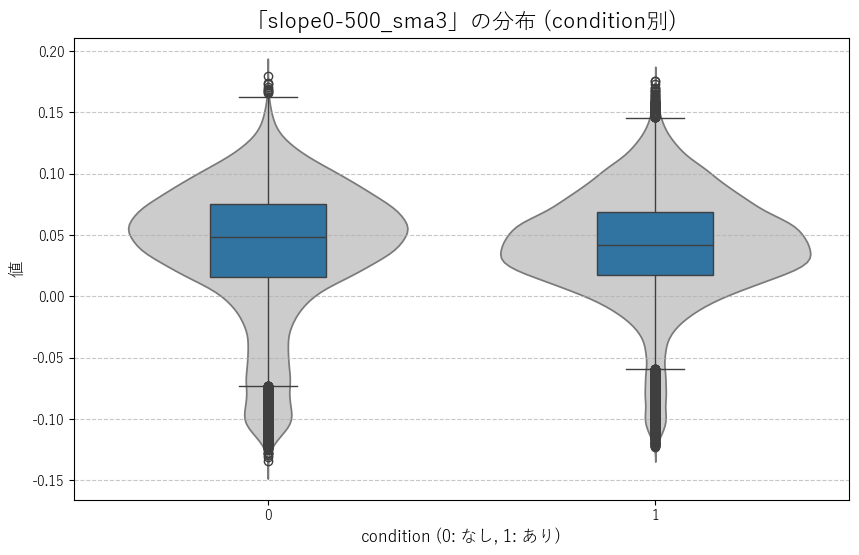

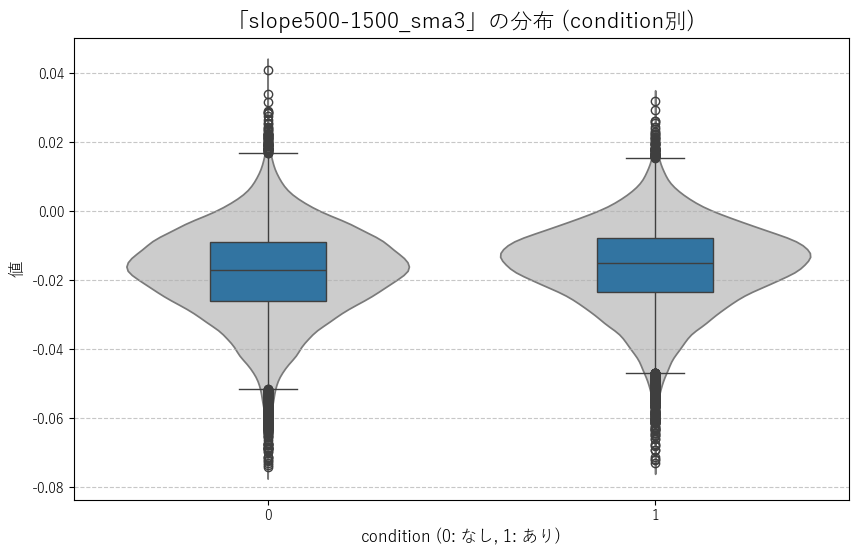

...

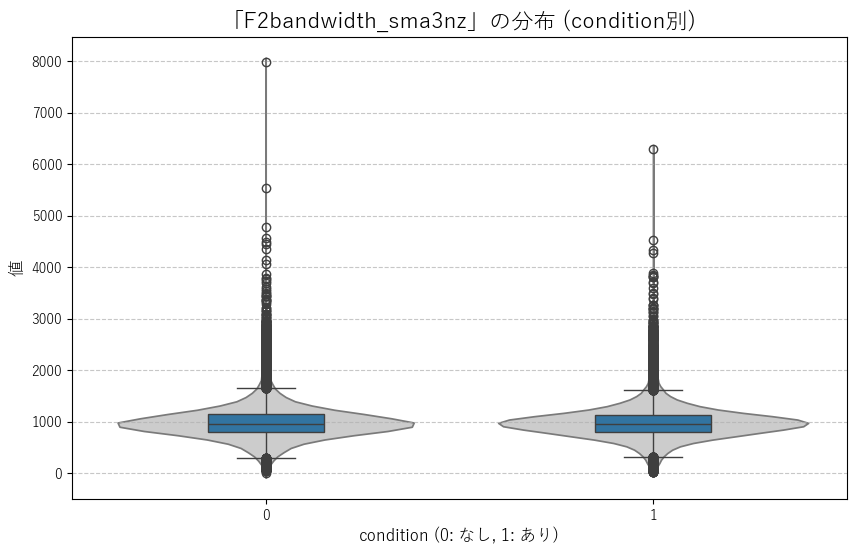

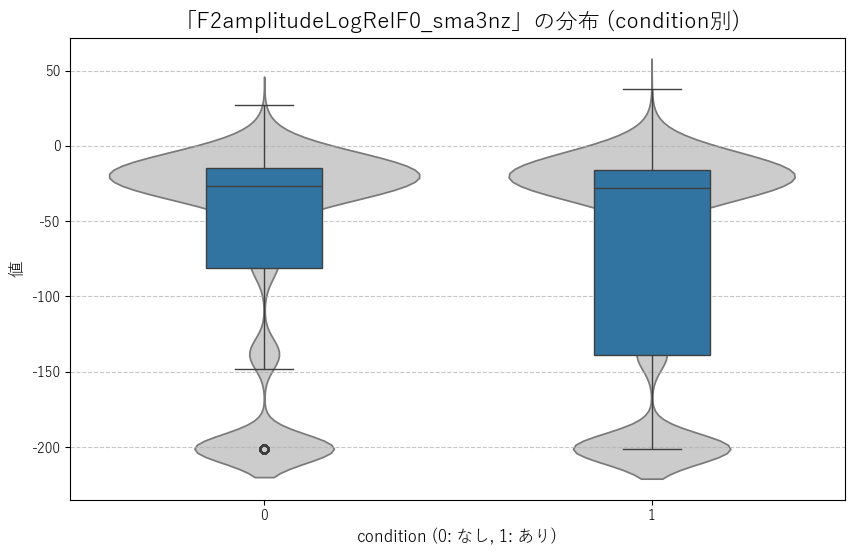

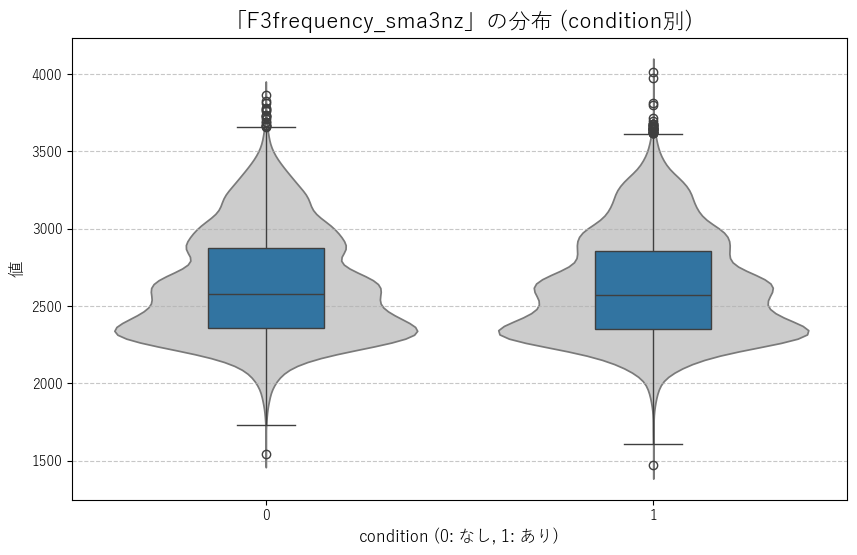

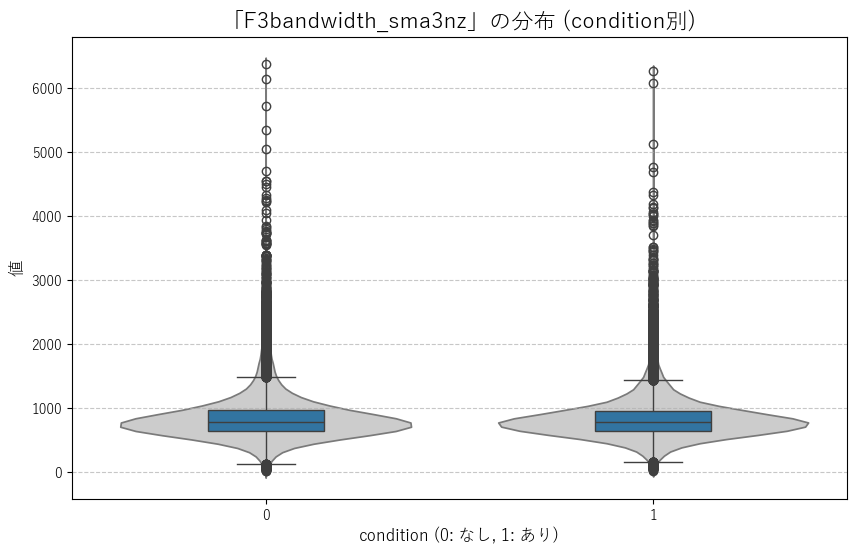

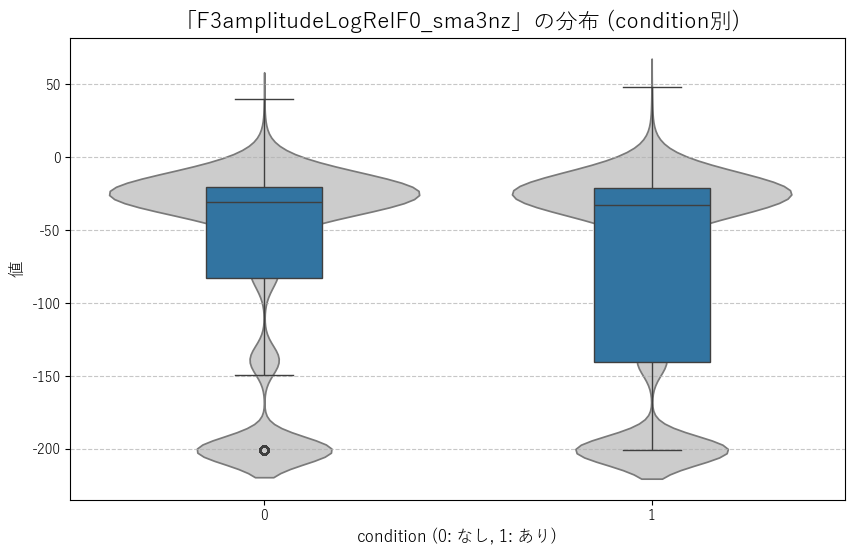


--- データ全体像の可視化 ---


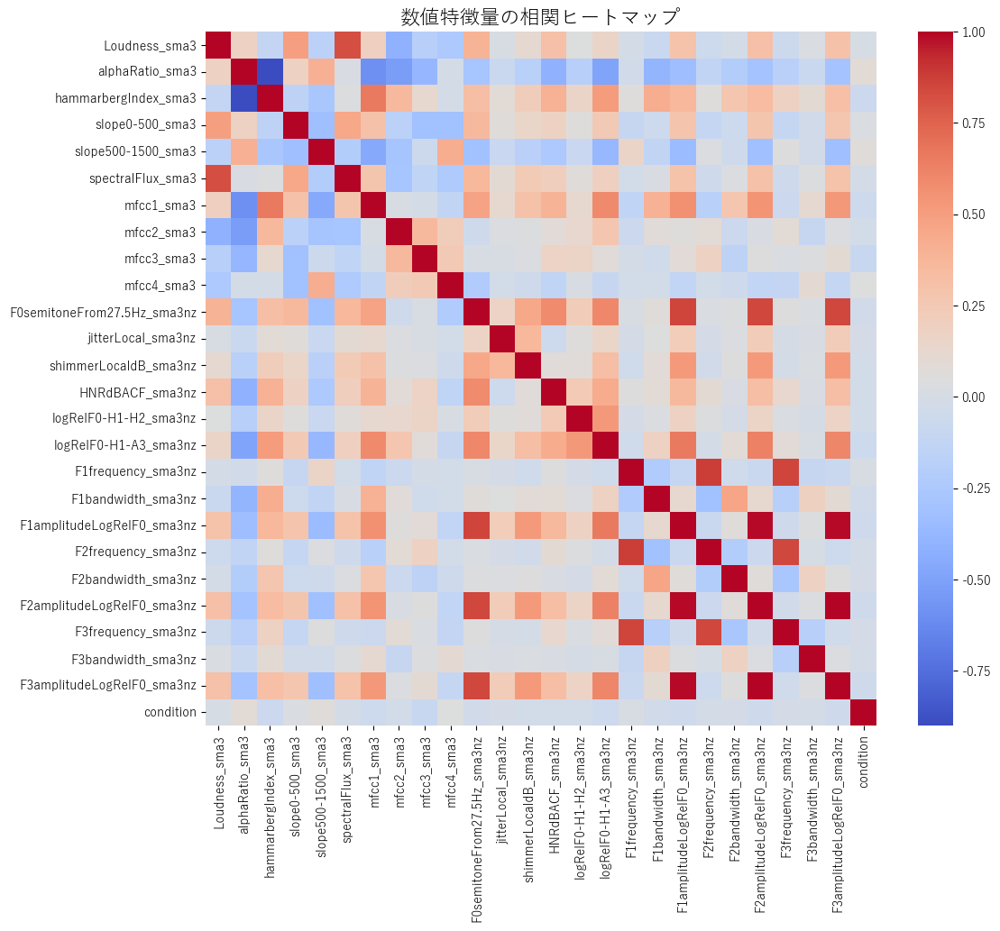


--- 全ての分析が完了しました ---

--- 特徴量 'F2amplitudeLogRelF0_sma3nz' と 'F3amplitudeLogRelF0_sma3nz' の関係性比較 ---


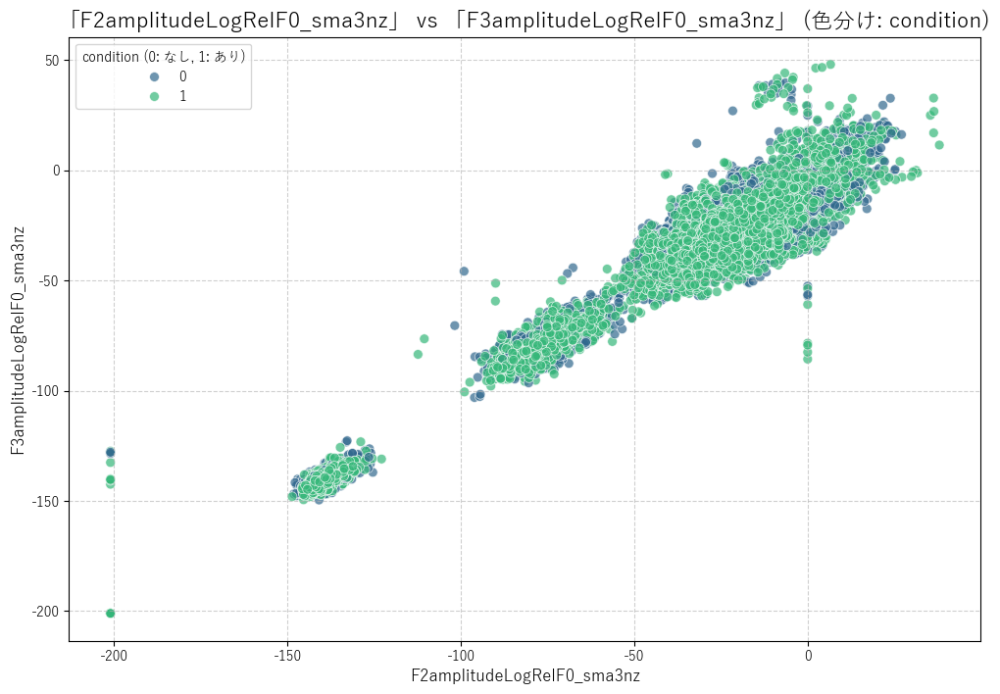

In [1]:
import pandas as pd
import numpy as np
import glob
import os
import re
import seaborn as sns
import matplotlib.pyplot as plt

# 日本語フォントの設定（文字化け対策）
plt.rcParams['font.sans-serif'] = ['Yu Gothic', 'Arial Unicode MS', 'Meiryo']
plt.rcParams['axes.unicode_minus'] = False 

# ======================================================================
# 関数定義パート
# ======================================================================

def process_csvs_into_dict(input_folder, new_column_name, values_list, column_to_filter='label', columns_to_drop=None):
    """指定フォルダ内の各CSVファイルを個別に処理し、その結果を辞書に格納して返します。"""
    if not os.path.isdir(input_folder):
        print(f"エラー: 入力フォルダ '{input_folder}' が見つかりません。")
        return {}
    
    csv_pattern = os.path.join(input_folder, '*.csv')
    csv_files = glob.glob(csv_pattern)
    def extract_number(filename):
        match = re.search(r'\d+', os.path.basename(filename))
        return int(match.group()) if match else 0
    csv_files.sort(key=extract_number)

    if not csv_files:
        print(f"フォルダ '{input_folder}' にCSVファイルが見つかりませんでした。")
        return {}
        
    if len(csv_files) != len(values_list):
        print(f"警告: ファイル数 ({len(csv_files)}) と値のリストの長さ ({len(values_list)}) が一致しません。")

    processed_dfs = {}
    print("--- 各ファイルの処理を開始 ---")
    for i, file_path in enumerate(csv_files):
        basename = os.path.basename(file_path)
        try:
            df = pd.read_csv(file_path, encoding='utf-8')
            if i < len(values_list):
                df[new_column_name] = values_list[i]
            else:
                df[new_column_name] = None
            if column_to_filter and column_to_filter in df.columns:
                target_labels = [f'answer{j}' for j in range(1, 11)]
                df = df[df[column_to_filter].astype(str).str.strip().isin(target_labels)].copy()
            if columns_to_drop:
                df = df.drop(columns=[col for col in columns_to_drop if col in df.columns], errors='ignore')
            df.reset_index(drop=True, inplace=True)
            processed_dfs[basename] = df
        except Exception as e:
            print(f"  ** エラー: ファイル '{basename}' の処理中に問題が発生しました: {e} **")
            continue
    print("\n--- 全てのファイルの処理が完了しました ---")
    return processed_dfs

def compare_features_by_condition(df, features, target_col):
    """指定した特徴量の分布を、ターゲット変数のグループごとに比較して可視化します。"""
    print(f"\n--- 特徴量ごとの分布比較 (by {target_col}) ---")
    for feature in features:
        plt.figure(figsize=(10, 6))
        sns.violinplot(x=target_col, y=feature, data=df, inner=None, color=".8")
        sns.boxplot(x=target_col, y=feature, data=df, width=0.3)
        plt.title(f'「{feature}」の分布 ({target_col}別)', fontsize=16)
        plt.xlabel(f'{target_col} (0: なし, 1: あり)', fontsize=12)
        plt.ylabel('値', fontsize=12)
        plt.grid(axis='y', linestyle='--', alpha=0.7)
        plt.show()

### ▼▼▼ 追加箇所1：2つの特徴量を比較するための新しい関数 ▼▼▼ ###
def plot_two_features_comparison(df, feature1, feature2, target_col):
    """指定した2つの特徴量の関係性を、ターゲット変数のグループごとに色分けして散布図で可視化します。"""
    print(f"\n--- 特徴量 '{feature1}' と '{feature2}' の関係性比較 ---")
    
    # 2つの特徴量がデータフレームに存在するかチェック
    if feature1 not in df.columns or feature2 not in df.columns:
        print(f"エラー: 指定された特徴量 '{feature1}' または '{feature2}' がデータに存在しません。")
        # 存在する列名の一覧を表示
        print("利用可能な列名:", list(df.columns))
        return

    plt.figure(figsize=(12, 8))
    # `hue`にターゲット列を指定することで、クラスごとに色分けされた散布図を作成
    sns.scatterplot(x=feature1, y=feature2, hue=target_col, data=df, alpha=0.7, s=50, palette='viridis')
    plt.title(f'「{feature1}」 vs 「{feature2}」 (色分け: {target_col})', fontsize=16)
    plt.xlabel(f'{feature1}', fontsize=12)
    plt.ylabel(f'{feature2}', fontsize=12)
    plt.legend(title=f'{target_col} (0: なし, 1: あり)')
    plt.grid(True, linestyle='--', alpha=0.6)
    plt.show()
### ▲▲▲ 追加箇所1 ▲▲▲ ###


def analyze_data(data_dict, target_col_name):
    """前処理済みのDataFrame辞書から、データ分析と可視化を包括的に行います。"""
    # (この関数の中身は変更なし)
    if not data_dict:
        print("分析対象のデータがありません。処理を終了します。")
        return None
    print("\n\n--- データの分析を開始 ---")
    combined_df = pd.concat(data_dict.values(), ignore_index=True)
    print("全データを1つのDataFrameに結合しました。")
    print(f"総行数: {len(combined_df)}, 総列数: {len(combined_df.columns)}")
    print("\n--- データ概要 ---")
    combined_df.info()
    print("\n--- 基本統計量（数値データ） ---")
    print(combined_df.describe())
    feature_columns = combined_df.columns.drop(['label', target_col_name])
    print(f"\n--- {target_col_name}別 の基本統計量比較 ---")
    grouped_stats = combined_df.groupby(target_col_name)[feature_columns].describe().T
    print(grouped_stats)
    compare_features_by_condition(combined_df, feature_columns, target_col_name)
    print("\n--- データ全体像の可視化 ---")
    numeric_df = combined_df.select_dtypes(include=['number'])
    if not numeric_df.empty:
        plt.figure(figsize=(12, 10))
        correlation_matrix = numeric_df.corr()
        sns.heatmap(correlation_matrix, annot=False, cmap='coolwarm')
        plt.title('数値特徴量の相関ヒートマップ', fontsize=16)
        plt.show()
    print("\n--- 全ての分析が完了しました ---")
    return combined_df

# ======================================================================
# 実行パート
# ======================================================================

if __name__ == '__main__':
    # --- パラメータ設定 ---
    input_folder_path = './voice_csv'
    columns_to_remove = ['start', 'end', 'original_start', 'original_end'] 
    values_for_files = [0,0,1,0,1,0,0,0,0,0,0,0,0,1,1,0,1,0,1,0,0,0,0,0,1,0,1,1,0,0,0,0,0,1,0,1,0,0,0,1,1,1,1,0,1,1,1,0,1,1,1,1,1,1,1,1,1,1,0,0,1,1,1,1,1] 
    new_column_name_to_add = 'condition'

    # --- ステップ1: データの前処理と読み込み ---
    all_data_dfs_dict = process_csvs_into_dict(
        input_folder_path,
        new_column_name=new_column_name_to_add,
        values_list=values_for_files,
        column_to_filter='label', 
        columns_to_drop=columns_to_remove
    )

    # --- ステップ2: 統合的なデータ分析の実行 ---
    if all_data_dfs_dict:
        final_combined_df = analyze_data(all_data_dfs_dict, new_column_name_to_add)

        ### ▼▼▼ 追加箇所2：上で定義した関数を使って、特定の2列をプロット ▼▼▼ ###
        # この final_combined_df が None でないことを確認
        if final_combined_df is not None:
            # --- ★★★ ここに比較したい2つの列名を指定してください ★★★ ---
            # 例としてeGeMAPSに含まれる特徴量名を使っています。
            # 実際に存在する列名に書き換えてください。
            COLUMN_TO_PLOT_1 = 'F2amplitudeLogRelF0_sma3nz' 
            COLUMN_TO_PLOT_2 = 'F3amplitudeLogRelF0_sma3nz'
            
            # 関数を呼び出してプロットを実行
            plot_two_features_comparison(
                df=final_combined_df,
                feature1=COLUMN_TO_PLOT_1,
                feature2=COLUMN_TO_PLOT_2,
                target_col=new_column_name_to_add
            )
        ### ▲▲▲ 追加箇所2 ▲▲▲ ###

In [2]:
import pandas as pd
import os
import re
import seaborn as sns
import matplotlib.pyplot as plt

# 日本語フォントの設定（ご自身の環境に合わせてフォント名を変更してください）
# 例: Windows -> 'MS Gothic', Mac -> 'Hiragino Sans'
plt.rcParams['font.sans-serif'] = ['Yu Gothic', 'Arial Unicode MS', 'Meiryo']
plt.rcParams['axes.unicode_minus'] = False # マイナス記号の文字化け対策

def analyze_single_file_correlation(file_path, columns_to_drop=None, column_to_filter='label'):
    """
    単一のCSVファイルを読み込み、前処理を行った後、
    数値特徴量の自己相関係数を計算し、ヒートマップで可視化します。

    Args:
        file_path (str): 分析対象のCSVファイルへのパス。
        columns_to_drop (list, optional): 削除したい列名のリスト。Defaults to None.
        column_to_filter (str, optional): フィルタリングの基準となる列名。Defaults to 'label'.
    """
    # --- 1. ファイルの存在確認 ---
    if not os.path.exists(file_path):
        print(f"エラー: ファイル '{file_path}' が見つかりません。")
        return

    basename = os.path.basename(file_path)
    print(f"--- ファイル '{basename}' の分析を開始 ---")

    try:
        # --- 2. ファイルの読み込み ---
        df = pd.read_csv(file_path, encoding='utf-8')
        print(f"読み込み成功: {len(df)}行, {len(df.columns)}列")

        # --- 3. 'label'列の値に基づいて行をフィルタリング ---
        if column_to_filter and column_to_filter in df.columns:
            target_labels = [f'answer{i}' for i in range(1, 11)]
            original_rows = len(df)
            df = df[df[column_to_filter].isin(target_labels)].copy()
            print(f"'{column_to_filter}' 列でフィルタリングを実行。({original_rows}行 -> {len(df)}行)")

        # --- 4. 不要な列を削除 ---
        if columns_to_drop:
            existing_cols_to_drop = [col for col in columns_to_drop if col in df.columns]
            if existing_cols_to_drop:
                df = df.drop(columns=existing_cols_to_drop)
                print(f"不要な列を削除しました: {existing_cols_to_drop}")

        # --- 5. 数値データのみを選択 ---
        numeric_df = df.select_dtypes(include=['number'])
        if numeric_df.empty:
            print("警告: 相関を計算できる数値データがありません。")
            return
        print(f"相関分析の対象となる数値特徴量: {numeric_df.columns.tolist()}")

        # --- 6. 自己相関係数を計算 ---
        print("\n--- 自己相関係数（相関行列）---")
        correlation_matrix = numeric_df.corr()
        print(correlation_matrix)

        # --- 7. ヒートマップで可視化 ---
        print("\n--- 相関ヒートマップの描画 ---")
        plt.figure(figsize=(12, 10))
        sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', annot_kws={"size": 10})
        plt.title(f'特徴量の相関ヒートマップ\n(ファイル: {basename})', fontsize=16)
        plt.xticks(rotation=45, ha='right')
        plt.yticks(rotation=0)
        plt.tight_layout() # レイアウトを自動調整

        # ヒートマップを画像ファイルとして保存
        heatmap_filename = f"correlation_heatmap_{os.path.splitext(basename)[0]}.png"
        plt.savefig(heatmap_filename)
        plt.close() # プロットを閉じる
        print(f"✅ ヒートマップを '{heatmap_filename}' という名前で保存しました。")


    except Exception as e:
        print(f"** エラー: ファイル処理中に予期せぬ問題が発生しました: {e} **")

# ===============================================================
# === 実行パート ===
# ===============================================================

# 1. 分析したい特定のCSVファイルのパスを指定してください
# (例: './voice_csv/1.csv')
target_file_path = './voice_csv/ID30_30_answers.csv'

# 2. 削除したい列の名前のリスト
columns_to_remove = ['start', 'end', 'original_start', 'original_end']

# 3. 分析関数を実行
analyze_single_file_correlation(
    file_path=target_file_path,
    columns_to_drop=columns_to_remove,
    column_to_filter='label'
)

--- ファイル 'ID30_30_answers.csv' の分析を開始 ---
読み込み成功: 960行, 30列
'label' 列でフィルタリングを実行。(960行 -> 960行)
不要な列を削除しました: ['start', 'end', 'original_start', 'original_end']
相関分析の対象となる数値特徴量: ['Loudness_sma3', 'alphaRatio_sma3', 'hammarbergIndex_sma3', 'slope0-500_sma3', 'slope500-1500_sma3', 'spectralFlux_sma3', 'mfcc1_sma3', 'mfcc2_sma3', 'mfcc3_sma3', 'mfcc4_sma3', 'F0semitoneFrom27.5Hz_sma3nz', 'jitterLocal_sma3nz', 'shimmerLocaldB_sma3nz', 'HNRdBACF_sma3nz', 'logRelF0-H1-H2_sma3nz', 'logRelF0-H1-A3_sma3nz', 'F1frequency_sma3nz', 'F1bandwidth_sma3nz', 'F1amplitudeLogRelF0_sma3nz', 'F2frequency_sma3nz', 'F2bandwidth_sma3nz', 'F2amplitudeLogRelF0_sma3nz', 'F3frequency_sma3nz', 'F3bandwidth_sma3nz', 'F3amplitudeLogRelF0_sma3nz']

--- 自己相関係数（相関行列）---
                             Loudness_sma3  alphaRatio_sma3  \
Loudness_sma3                     1.000000         0.892249   
alphaRatio_sma3                   0.892249         1.000000   
hammarbergIndex_sma3             -0.886386        -0.921947   
sl